# DL Project - Unsupervised Domain Adaptation
### Adversarial feature augmentation
#### Battocchio Joy, Guidolin Davide

\\

Deep learning course, AA 2021/2022

Prof. Elisa Ricci

Unsupervised Domain Adaptation:

It is often the case that after the training phase of a model, its real usage happen in a different domain (target domain) with respect to the one in which it has been trained (source domain).
This may cause a significant drop in the performance of the model.
If some data of the target domain are available, but its ground truth labels are not, it is possibile to improve the performance via the so called *unsupervised domain adaptations*.
There are many examples of different techniques that implement UDA in the literature, here we present ours.

Dataset:

In this assignment we train and evaluate our model on a subset of the *Adaptiope* object recognition dataset, using two of its domain (*real world* and *product*) and only 20 out of the 123 classes.


Implementation:

This work is an ad-hoc implementation of the paper [***Adversarial Feature Augmentation for Unsupervised Domain Adaptation***](https://openaccess.thecvf.com/content_cvpr_2018/papers/Volpi_Adversarial_Feature_Augmentation_CVPR_2018_paper.pdf) by Volpi, R., Morerio, P., Savarese, S., & Murino, V. (2017).
It aims to solve the domain shift problem by training adversarially a discriminator and a feature generator that tries to fool it by generating source domain features as similar as possible to the ones that come from the encoder (step 1).
After that it uses another GAN to train a second encoder (initialized as the first one and fine-tuned) that aims to produce similar features for both domains by fooling a discriminator fed with its output, and the output coming from the previous step generator (generated source features only) (step 2).

This should produce a domain invariant encoder that is able to generate similar features for both the domains. The generated features are similar to the features genereated by the encoder trained on the source images (for which we have the labels), in this way we can use the domain invariant encoder along with the classifier trained on the source images to classify the images from both the domains. 

\\

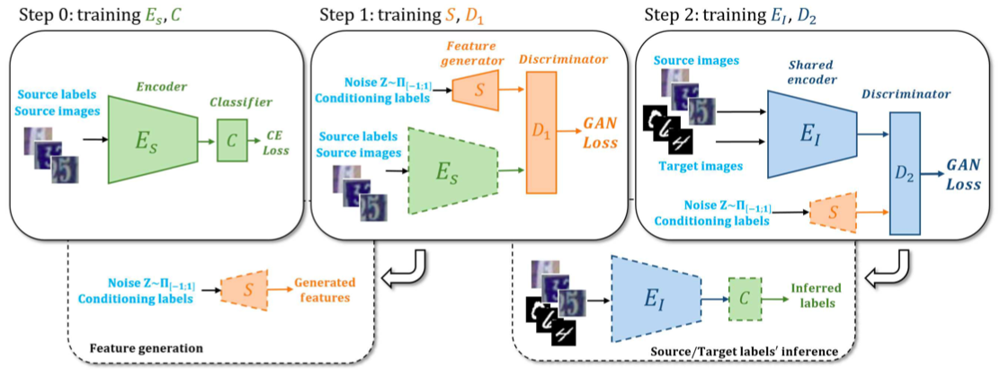

**In the image above, the modules with dotted borders are used to infer, while the ones with solid borders are trained.**

The solution proposed above has been implemented for digits recognition in MNIST dataset, therefore the model as presented in the paper was not perfect for our purpose.

Among the other problems we found, surely the most challenging one was to train the two GAN. The small dataset and the too simple structure of the generator and discriminator made it really difficult to stabilize the training and to have significant results. We also couldn't rely on deep structures because the training time was already too much.

Many solutions has been tried to solve these issues, they will be explained in details in each section.

Notation: since the assignment is to perform domain adaptation in both ways, from now on for simplicity we will refer to the product domain as **source domain**, and to the real world domain as **target domain**.

## Dataset Loading

In this section we load the dataset and we inspect it.

We also found necessary to augment it in order to have a much more stable training of the GAN, as well as more general features.

### Dataset loading

In [ ]:
import os
from os import makedirs, listdir
from os.path import join
from shutil import copytree, move, rmtree, copyfile
from tqdm import tqdm
from google.colab import drive

import numpy as np
import torch
import torchvision
from torch.utils.tensorboard import SummaryWriter

from torchvision.transforms import transforms, Grayscale, RandomRotation, GaussianBlur, ColorJitter, RandomHorizontalFlip, RandomVerticalFlip, RandomErasing, RandomApply
from torchvision.transforms.functional import get_image_size, to_pil_image
from torch.utils.data import DataLoader, ConcatDataset
import torch.nn.functional as F
import torch.nn as nn

import matplotlib.pyplot as plt
from sklearn.metrics import ConfusionMatrixDisplay

In [ ]:
drive.mount('/content/gdrive')

Mounted at /content/gdrive


In [ ]:
!mkdir dataset
!cp "gdrive/My Drive/datasets/Adaptiope.zip" dataset/
!ls dataset

Adaptiope.zip


In [ ]:
%%capture
!unzip dataset/Adaptiope.zip

In [ ]:
!rm -rf adaptiope_small

In [ ]:
!mkdir adaptiope_small
classes = listdir("Adaptiope/product_images")
classes = ["backpack", "bookcase", "car jack", "comb", "crown", "file cabinet", "flat iron", "game controller", "glasses",
           "helicopter", "ice skates", "letter tray", "monitor", "mug", "network switch", "over-ear headphones", "pen",
           "purse", "stand mixer", "stroller"]
for d, td in zip(["Adaptiope/product_images", "Adaptiope/real_life"], ["adaptiope_small/product_images", "adaptiope_small/real_life"]):
    makedirs(td)
    for c in tqdm(classes):
        c_path = join(d, c)
        c_target = join(td, c)
        copytree(c_path, c_target)

100%|██████████| 20/20 [00:05<00:00,  3.92it/s]


### Inspection and Visualization

First of all we check how many images there are for each class in the dataset

In [ ]:
image_counts = {
    "product_images": {},
    "real_life": {}
}

# count the images in each folder
base_folder = "adaptiope_small/"
for folder in image_counts:
    for klass in classes:
        path = join(base_folder, folder, klass)
        image_counts[folder][klass] = len(listdir(path))

print(f"Number of classes: {len(classes)}")
print("Number of images for each class:")
for folder in image_counts:
    print(f"\n{folder}:")
    for klass in classes:
        print(f"\t{klass:20} {image_counts[folder][klass]}")

Number of classes: 20
Number of images for each class:

product_images:
	backpack             100
	bookcase             100
	car jack             100
	comb                 100
	crown                100
	file cabinet         100
	flat iron            100
	game controller      100
	glasses              100
	helicopter           100
	ice skates           100
	letter tray          100
	monitor              100
	mug                  100
	network switch       100
	over-ear headphones  100
	pen                  100
	purse                100
	stand mixer          100
	stroller             100

real_life:
	backpack             100
	bookcase             100
	car jack             100
	comb                 100
	crown                100
	file cabinet         100
	flat iron            100
	game controller      100
	glasses              100
	helicopter           100
	ice skates           100
	letter tray          100
	monitor              100
	mug                  100
	network switch       100
	over-

Now we visualize one image for each class for both the source and target domain

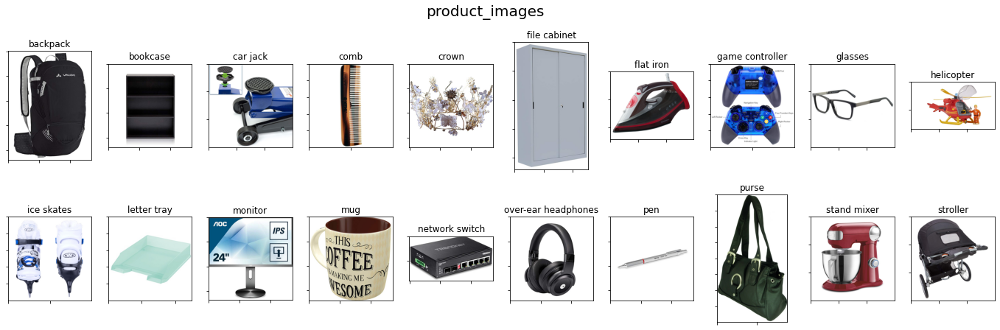

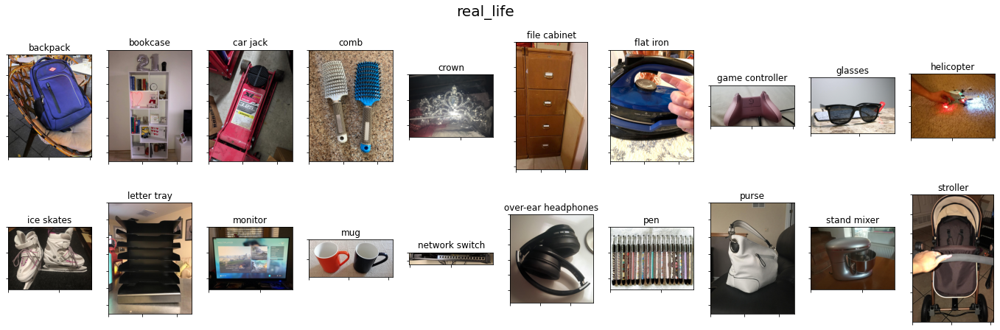

In [ ]:
base_folder = "adaptiope_small/"
nrows = 2
ncols = 10

# for product_images and real_life
for folder in image_counts:
    # create figure
    fig = plt.figure(figsize=(24, 7))
    fig.suptitle(folder, fontsize=20)

    # add subplots to create 2x10 grid
    ax = [ fig.add_subplot(nrows, ncols, r * ncols + c + 1) for r in range(0, nrows) for c in range(0, ncols) ]
    
    # show an image for each class in each subplot
    for i, klass in enumerate(classes):
        path = join(base_folder, folder, klass)
        image_path = join(path, listdir(path)[0])
        im = plt.imread(image_path)
        
        ax[i].imshow(im)
        ax[i].set_title(klass)
    
    for a in ax:
        a.set_xticklabels([])
        a.set_yticklabels([])
        a.set_aspect('equal')

    plt.show()
    print("\n\n")

We can see that the images have different sizes, so we will need to resize them to have the same size for all the data.

### Creation of Dataloaders
Here we create the dataloaders that will be ready for use during training and testing.


We need to modify a bit the dataset folder to subdivide it into training, validation and test folders. We do it because if we load the entire folder using the `torchvision.datasets.ImageFolder` class we will not be able to split the dataset and at the same time keep the balance between classes. In this way we split the dataset in 3 folders and then we can use `ImageFolder` with each folder.

In [ ]:
def split_data(train=0.8, test=0.2):

    idxs = np.arange(0, 100)
    #np.random.shuffle(idxs)

    # split each class of 100 images in train/test 
    n_train = int(len(idxs) * train)
    train_idxs = idxs[:n_train]
    test_idxs = idxs[n_train:]
    
    base_path = 'adaptiope_small'
    for folder in ['adaptiope_small/train/', 'adaptiope_small/test/']:
        
        for subfolder in ['product_images/', 'real_life/']:
            path = join(folder, subfolder)
            if not os.path.exists(path):
                makedirs(path)
            
            for klass in classes:
                if not os.path.exists(join(path, klass)):
                    makedirs(join(path, klass))

                if 'train' in folder:
                    # move the first train_idxs images of the klass in adaptiope_small/train/{subfolder}/{klass}/
                    for i in train_idxs:
                        image_path_src = join(base_path, subfolder, klass, f"{klass}_0{i:02d}.jpg")
                        image_path_dst = join(folder, subfolder, klass, f"{klass}_0{i:02d}.jpg")
                        move(image_path_src, image_path_dst)
                
                if 'test' in folder:
                    # move the rest of the images of the klass in adaptiope_small/test/{subfolder}/{klass}/
                    for i in test_idxs:
                        image_path_src = join(base_path, subfolder, klass, f"{klass}_0{i:02d}.jpg")
                        image_path_dst = join(folder, subfolder, klass, f"{klass}_0{i:02d}.jpg")
                        move(image_path_src, image_path_dst)

    # delete old folders
    rmtree("adaptiope_small/product_images")
    rmtree("adaptiope_small/real_life")

In [ ]:
split_data()

NameError: ignored

Now we define the function used to create the dataloaders that will be used during training and testing.

First of all we apply the resize to all the images and then we apply the augmentation.

The chosen transformation for the augmented part are the following:
1.   Rotation
2.   Horizonatl flip
3.   Vertical flip
4.   Color jitter

They are applied randomly in order to have a set that is more eterogeneous.

We tried many other transformations but these showed to be the best ones for our purpose.

In [ ]:
def data_augmentation(folder_root, size, threshold=0.7, n_aug=4):

    # transformation used for augmentation
    transformations = [
                RandomRotation(degrees=90, fill=255), 
                RandomHorizontalFlip(p=1.0), 
                RandomVerticalFlip(p=1.0),
                ColorJitter(0.5, 0.5, 0.5, 0.5)
            ]

    datasets = []

    for i in range(n_aug):
        # first of all resize the image
        tr = [transforms.Resize(size)]

        # randomly apply each transformation with probability=threshold
        for t in transformations:
            tr.append(RandomApply([t], p=threshold))
        
        tr.append(transforms.ToTensor())
        tr = transforms.Compose(tr)
        # apply the transformations to the images stored in folder_root
        d = torchvision.datasets.ImageFolder(folder_root, transform=tr)
        datasets.append(d)
    
    # concatenate the n_aug augmented datasets
    return ConcatDataset(datasets)    

Here we create the dataloaders. We apply augmentation to the training datasets but not to the mixed dataset (dataset that contains both source and target images) because it will be used only in the last GAN for which we don't need augmented images.

In [ ]:
def get_data(batch_size=128, size=(224, 224)):

    # standard transformations applied to all the images
    train_transform = transforms.Compose([
        transforms.Resize(size),
        transforms.ToTensor()
    ])

    test_transform = transforms.Compose([
        transforms.Resize(size),
        transforms.ToTensor()
    ])

    train_source_root = "adaptiope_small/train/product_images"
    train_target_root = "adaptiope_small/train/real_life"
    test_source_root = "adaptiope_small/test/product_images"
    test_target_root = "adaptiope_small/test/real_life"

    # DATASETS

    # train source dataset
    train_source_dataset_standard = torchvision.datasets.ImageFolder(train_source_root, transform=train_transform)
    train_source_dataset_augmented = data_augmentation(train_source_root, size=size)
    train_source_dataset = ConcatDataset([train_source_dataset_standard, train_source_dataset_augmented])

    # train target dataset
    train_target_dataset_standard = torchvision.datasets.ImageFolder(train_target_root, transform=train_transform)
    train_target_dataset_augmented = data_augmentation(train_target_root, size=size)
    train_target_dataset = ConcatDataset([train_target_dataset_standard, train_target_dataset_augmented])
    
    # train mixed dataset
    train_mixed_dataset = ConcatDataset([train_source_dataset_standard, train_target_dataset_standard])
    
    # test datasets
    test_source_dataset = torchvision.datasets.ImageFolder(test_source_root, transform=test_transform)
    test_target_dataset = torchvision.datasets.ImageFolder(test_target_root, transform=test_transform)
    test_mixed_dataset = ConcatDataset([test_source_dataset, test_target_dataset])
    
    # DATALOADERS

    # train dataloaders
    train_source_loader = DataLoader(train_source_dataset, batch_size=batch_size, shuffle=True)
    train_target_loader = DataLoader(train_target_dataset, batch_size=batch_size, shuffle=True)
    train_source_loader_notAug = DataLoader(train_source_dataset_standard, batch_size=batch_size, shuffle=True)
    train_target_loader_notAug = DataLoader(train_target_dataset_standard, batch_size=batch_size, shuffle=True)
    train_mixed_loader = DataLoader(train_mixed_dataset, batch_size=batch_size, shuffle=True)

    # test dataloaders
    test_source_loader = DataLoader(test_source_dataset, batch_size=batch_size, shuffle=False)
    test_target_loader = DataLoader(test_target_dataset, batch_size=batch_size, shuffle=False)
    test_mixed_loader = DataLoader(test_mixed_dataset, batch_size=batch_size, shuffle=False)



    return train_source_loader, train_target_loader, train_mixed_loader, train_source_loader_notAug, train_target_loader_notAug, test_source_loader, test_target_loader, test_mixed_loader

In [ ]:
BATCH_SIZE = 128

# instantiates dataloaders
train_source_loader, train_target_loader, train_mixed_loader, train_source_loader_notAug, train_target_loader_notAug, \
test_source_loader, test_target_loader, test_mixed_loader = get_data(batch_size=BATCH_SIZE)

In [ ]:
# folder in which we save the models and the training checkpoints
MODELS_PATH = "/content/gdrive/MyDrive/Models_50/"
# folder in which we save the logs
LOGS_PATH = "/content/gdrive/MyDrive/Logs/runs"

## **Step 0**: baseline Model (encoder fine-tuning)

In this section we will train the model that will be used as baseline.
We will use a pretrained ResNet network and we will fine tune it on our data.

The baseline consists of the accuracy score obtained by testing the model on the target domain after training it on the source domain (and viceversa) without UDA.

\\

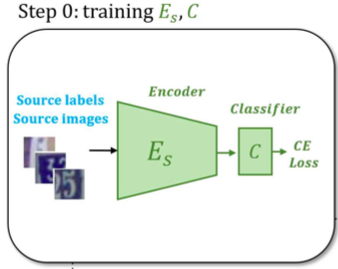

### Resnet initialization

We start by initializing the network and changing the last layer to make it output 20 classes instead of 1000

In [ ]:
import torchvision.models as models

def init_resnet(n_classes, size=18, pretrained=True):

    # use the correct ResNet based on the size parameter
    if size == 18:
        resnet = models.resnet18(pretrained=pretrained)
    elif size == 34:
        resnet = models.resnet34(pretrained=pretrained)
    elif size == 50:
        resnet = models.resnet50(pretrained=pretrained)
    else:
        print(f"Size {size} not supported for resnet. Using resnet 18")
        resnet = models.resnet18(pretrained=pretrained)

    # get size of input features to the final layer
    in_features = resnet.fc.in_features

    # replace the final layer with a Linear layer that outputs n_classes values
    resnet.fc = torch.nn.Linear(in_features=in_features, out_features=n_classes)

    return resnet

### Cost Function

As cost function we will use a Cross Entropy Loss.

In [ ]:
def get_cost_function():
    cost_function = torch.nn.CrossEntropyLoss()
    return cost_function

### Optimizer

We use Adam as optimizer with a learning rate reduced by a factor of 10 for the parameters of the network that are not in the last layer.

In [ ]:
def get_optimizer(model, lr, weight_decay):
    final_layer_weights = []
    other_weights = []

    for name, param in model.named_parameters():
        if name.startswith('fc.'):  # get final layer weights
            final_layer_weights.append(param)
        else:  # get other weights
            other_weights.append(param)
    
    # create optimizer
    optimizer = torch.optim.Adam([
        {'params': other_weights},
        {'params': final_layer_weights, 'lr': lr}
    ], lr = lr/10, weight_decay=weight_decay)

    return optimizer

### Training and test functions

Now we define the function used for training and evaluation.

In [ ]:
def training_step(net, data_loader, optimizer, cost_function, device='cuda'):

    samples = 0.
    cumulative_loss = 0.
    cumulative_accuracy = 0.

    # set the network to training mode
    net.train() 

    # iterate over the training set
    for batch_idx, (inputs, targets) in enumerate(data_loader):

        # load data into GPU
        inputs = inputs.to(device)
        targets = targets.to(device)
            
        # forward pass
        outputs = net(inputs)

        # loss computation
        loss = cost_function(outputs, targets)

        # backward pass
        loss.backward()

        # parameters update
        optimizer.step()

        # gradients reset
        optimizer.zero_grad()

        # fetch prediction and loss value
        samples += inputs.shape[0]
        cumulative_loss += loss.item()
        _, predicted = outputs.max(dim=1) # max() returns (maximum_value, index_of_maximum_value)

        # compute training accuracy
        cumulative_accuracy += predicted.eq(targets).sum().item()

    return cumulative_loss/samples, cumulative_accuracy/samples*100

def test_step(net, data_loader, cost_function, device='cuda'):

    samples = 0.
    cumulative_loss = 0.
    cumulative_accuracy = 0.

    outputs_all = []
    targets_all = []

    # set the network to evaluation mode
    net.eval() 

    # disable gradient computation
    with torch.no_grad():

        # iterate over the test set
        for batch_idx, (inputs, targets) in enumerate(data_loader):
      
            # load data into GPU
            inputs = inputs.to(device)
            targets = targets.to(device)
                
            # forward pass
            outputs = net(inputs)

            # loss computation
            loss = cost_function(outputs, targets)

            # fetch prediction and loss value
            samples += inputs.shape[0]
            cumulative_loss += loss.item()
            _, predicted = outputs.max(dim=1)

            # compute accuracy
            cumulative_accuracy += predicted.eq(targets).sum().item()

            outputs_all.extend(predicted.cpu().tolist())
            targets_all.extend(targets.cpu().tolist())

    return cumulative_loss/samples, cumulative_accuracy/samples*100, outputs_all, targets_all

### Training the networks

In [ ]:
def baseline(train_loader,
             test_loader,
             visualization_name,
             resnet_size=18,
             device='cuda:0', 
             learning_rate=0.001, 
             weight_decay=0.000001,
             epochs=20, 
             num_classes=20,
             log_path='/content/gdrive/MyDrive/Logs',
             start_patience=5):
  
    # instantiate the logger
    writer = SummaryWriter(log_dir=join(log_path, f'runs/{visualization_name}'))
    
    # instantiate the model
    net = init_resnet(n_classes=num_classes, size=resnet_size).to(device)
    
    # instantiate the optimizer
    optimizer = get_optimizer(net, learning_rate, weight_decay)
    
    # instantiates the cost function
    cost_function = get_cost_function()

    # early stopping
    best_acc = 0
    patience = start_patience

    # range over the number of epochs
    for e in range(epochs):
        train_loss, train_accuracy = training_step(net, train_loader, optimizer, cost_function)
        test_loss, test_accuracy = test_step(net, test_loader, cost_function)
        print('Epoch: {:d}'.format(e+1))
        print('\t Training loss {:.5f}, Training accuracy {:.2f}'.format(train_loss, train_accuracy))
        print('\t Test loss {:.5f}, Test accuracy {:.2f}'.format(test_loss, test_accuracy))
        
        # add values to logger
        writer.add_scalar('Loss/train_loss', train_loss, e + 1)
        writer.add_scalar('Loss/test_loss', test_loss, e + 1)
        writer.add_scalar('Accuracy/train_accuracy', train_accuracy, e + 1)
        writer.add_scalar('Accuracy/test_accuracy', test_accuracy, e + 1)

        # update patience for early stopping
        if test_accuracy > best_acc:
            best_acc = test_accuracy
            patience += 1 if patience < start_patience else 0
        else:
            patience -= 1

        print('\t Patience: {}'.format(patience))
        print('-----------------------------------------------------')

        if patience == 0:
            print(f"Patience at 0. Stopping training")
            break

    # perform final test step and print the final metrics
    print('After training:')
    train_loss, train_accuracy = test_step(net, train_loader, cost_function)
    test_loss, test_accuracy = test_step(net, test_loader, cost_function)

    print('\t Training loss {:.5f}, Training accuracy {:.2f}'.format(train_loss, train_accuracy))
    print('\t Test loss {:.5f}, Test accuracy {:.2f}'.format(test_loss, test_accuracy))
    print('-----------------------------------------------------')

    # close the logger
    writer.close()

    return net

For the baseline we use a ResNet50 and 0.0001 as learning rate.

Here we train the baseline for the **source domain**

In [ ]:
source_net = baseline(train_source_loader, test_target_loader, resnet_size=50, epochs=500, visualization_name='resnet50_baseline_source_new', learning_rate=0.0001, start_patience=5)
source_net = source_net.to('cpu')

After 11 epochs the patience goes to 0 and the training is stopped.

In [ ]:
# save the model
torch.save(source_net, f'{MODELS_PATH}/baseline_source.pt')

In [ ]:
# empty the gpu cache
torch.cuda.empty_cache()

Here we train the baseline for the **target domain**

In [ ]:
target_net = baseline(train_target_loader, test_source_loader, resnet_size=50, epochs=500, visualization_name='resnet50_baseline_target_new', learning_rate=0.0001, start_patience=5)
target_net = target_net.to('cpu')

After 13 epochs the patience goes to 0 and the training is stopped.

In [ ]:
# save the model
torch.save(target_net, f'{MODELS_PATH}/baseline_target.pt')

In [ ]:
torch.cuda.empty_cache()

In [ ]:
%load_ext tensorboard
%tensorboard --logdir=/content/gdrive/MyDrive/Logs/runs

<IPython.core.display.Javascript object>

### Baseline test

Trained on **source domain** and tested on **target domain**

In [ ]:
source_net = torch.load(f'{MODELS_PATH}/baseline_source.pt')

source_net.to('cuda:0')

loss, acc, outputs, targets = test_step(source_net, test_target_loader, get_cost_function())
print(f"Baseline accuracy on target domain: {acc}")

ConfusionMatrixDisplay.from_predictions(targets, outputs)
plt.show()

Trained on **target domain** and tested on **source domain**

In [ ]:
target_net = torch.load(f'{MODELS_PATH}/baseline_target.pt')

target_net.to('cuda:0')

loss, acc, outputs, targets = test_step(target_net, test_source_loader, get_cost_function(), device='cuda:0')
print(f"Baseline accuracy on source domain: {acc}")

ConfusionMatrixDisplay.from_predictions(targets, outputs)
plt.show()

### Upper bounds

The upper buond represents the best score we could achieve since it is the accuracy score obtained by training and testing the model on the same domain.
It implies the availability of the ground truth labels for the target domain since it is trained supervisedly.

Trained on **target domain** and tested on **target domain**.
It represent the upper bound for the **source → target** shift.

In [ ]:
target_net = torch.load(f'{MODELS_PATH}/baseline_target.pt')

target_net.to('cuda:0')

loss, acc, outputs, targets = test_step(target_net, test_target_loader, get_cost_function())
print(f"Upper bound accuracy on target domain: {acc}")

ConfusionMatrixDisplay.from_predictions(targets, outputs)
plt.show()

Trained on **source domain** and tested on **source domain**.
It represent the upper bound for the **target → source** shift.

In [ ]:
source_net = torch.load(f'{MODELS_PATH}/baseline_source.pt')

source_net.to('cuda:0')

loss, acc, outputs, targets = test_step(source_net, test_source_loader, get_cost_function(), device='cuda:0')
print(f"Upper bound accuracy on source domain: {acc}")

ConfusionMatrixDisplay.from_predictions(targets, outputs)
plt.show()

## **Step 1**: augmented features generator

**Step 1 of Adversarial Feature Augmentation.**

Gan structure: the discriminator aims to distinguish the features coming from the generator and the encoder used for the baseline. The generator tries learn to fool the discriminator by imitating the real features coming from the encoder. In this way we will be able to generate features that do not correspond to any image present in the dataset. 

Note that at this point the target domain data have not yet been used to guide the training.

\\

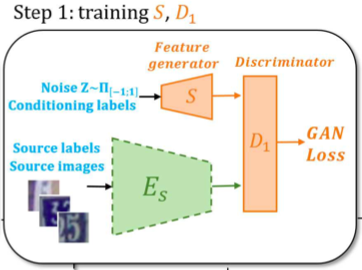

**Important differences with the paper:**

We soon discovered that the discriminator of this GAN tended to collapse on one prediction after just a few tens of epochs, and when it happens the generator just stop improving.
We tried to tune the hyper-parameters without much success.

We also had another issue, that is to understand if the GAN was doing well or not, and since the training takes one or two days to complete, we had to wait until we reached the end of it, test it and evaluate it based only on the accuracy score.

So we decided to change the losses of the generator and the discriminator in the following way:

\\

1.   Previous discriminator loss:
\begin{equation}
loss\_real + loss\_fake
\end{equation}

2.   Our discriminator loss:
\begin{equation}
loss\_real + loss\_fake + |loss\_real - loss\_fake|
\end{equation}
---
3.   Previous generator loss:
\begin{equation}
loss\_gen
\end{equation}
4.   Our generator loss: 
\begin{equation}
loss\_gen + features\_distance
\end{equation}
---
\\
By doing this we penalize the discriminator when the two losses are too different from each other, so it tends to keep them similar and in this way to keep the training more stable.
It has shown to delay enough the collapse to ensure a satisfiable training of the generator.

We also help the generator training by adding to its loss the mean squared distance between the generated features and the ones coming from the encoder.
This does not only help the generator, but also help us: by printing the feature distance every epoch we can have a good indicator of how the training is going without waiting it to be over.




### Preliminary steps

#### Split the backbone network


In [ ]:
def split_encoder_classifier(net):
    # take all the layers but the last one
    encoder_Es_source = torch.nn.Sequential(*(list(net.children())[:-1]))
    # take last layer
    classifier_C_source = torch.nn.Sequential(list(net.children())[-1])

    return encoder_Es_source, classifier_C_source

#### Definition of the features gan

In [ ]:
class FeatureGenerator(nn.Module):
    def __init__(self, noise_size, out_features):
        super(FeatureGenerator, self).__init__()
        
        self.generator = nn.Sequential(
            nn.Linear(in_features=noise_size, out_features=1024),
            nn.ReLU(),
            nn.BatchNorm1d(num_features=1024),
            nn.Dropout(p=0.5),

            nn.Linear(in_features=1024, out_features=2048),
            nn.ReLU(),
            nn.Dropout(p=0.5),

            nn.Linear(in_features=2048, out_features=2048),
            nn.ReLU(),
            nn.Dropout(p=0.5),

            nn.Linear(in_features=2048, out_features=1024),
            nn.ReLU(),
            nn.Dropout(p=0.5),

            nn.Linear(in_features=1024, out_features=out_features),
            nn.ReLU()
        )
    
    def forward(self, x):
        out = self.generator(x)
        return out

In [ ]:
class FeatureDiscriminator(nn.Module):
    def __init__(self, in_features):
        super(FeatureDiscriminator, self).__init__()

        self.discriminator = nn.Sequential(
            nn.Linear(in_features=in_features, out_features=1024),
            nn.ReLU(),

            nn.Linear(in_features=1024, out_features=1),
            nn.Sigmoid()
        )
    
    def forward(self, x):
        out = self.discriminator(x)
        return out

#### Generate noise and one hot labels

In [ ]:
def generate_noise(size):
    return torch.rand(size)

In [ ]:
def one_hot(labels, n_classes):
    # create tensor of zeros of size (n_labels, n_classes)
    one_hot = torch.zeros((len(labels), n_classes))

    # put a 1 in the correct label position
    for i in range(len(labels)):
        one_hot[i, labels[i]] = 1

    return one_hot

#### Define weight initialization

In [ ]:
def weight_init(m):
    classname = m.__class__.__name__
    
    if classname.find('BatchNorm') != -1:
      nn.init.normal_(m.weight.data, 0.0, 0.02)
      nn.init.constant_(m.bias.data, 0.0001)

    elif classname.find('Linear') != -1:
      nn.init.normal_(m.weight.data, 0.0, 0.02)
      nn.init.constant_(m.bias.data, 0.0001)

#### Define optimizers

In [ ]:
def get_feature_gan_optimizers(model_g, model_d, lr_g, lr_d):
    # generator optimizer
    g_optim = torch.optim.Adam(params=model_g.parameters(), lr=lr_g)

    # discriminator optimizer
    d_optim = torch.optim.Adam(params=model_d.parameters(), lr=lr_d)

    return g_optim, d_optim

#### Define loss function

In [ ]:
def get_loss():
    # use a Mean Squared Error Loss for better stability during training
    return torch.nn.MSELoss()

#### Init features gan

In [ ]:
def init_gan(feat_size, n_classes=20, noise_len=100):

    # create an input noise||one_hot_label to get the dimension of the noise||one_hot_label vector. The dimension is needed to instantiate the generator
    sample_noise = generate_noise((1, noise_len))
    oh_label = one_hot([1], n_classes)
    noise_labels = torch.cat((sample_noise, oh_label), dim=1)

    # instantiate generator and discriminator and initialize weights.
    netG = FeatureGenerator(noise_size=noise_labels.shape[1], out_features=feat_size[0])
    netG.apply(weight_init)

    netD = FeatureDiscriminator(in_features=feat_size[0])
    netD.apply(weight_init)

    return netG, netD


#### Add Gaussian Noise to inputs to the discriminator

Gaussian noise applied to the discriminator inputs is used to stabilise the training of the GAN.

https://www.inference.vc/instance-noise-a-trick-for-stabilising-gan-training/

In [ ]:
def gaussian_noise(tensor, mean=0.0, std_dev=0.1, device="cuda:0"):
    return tensor + torch.randn(tensor.size()).to(device) * std_dev + mean

#### Normalization and scaling

This function will be used to normalize the fake and real features for feature matching.

In [ ]:
def norm_scale(t1, t2):
    t1_norm = (t1 - torch.min(t1, 1).values.unsqueeze(-1)) / (torch.max(t1, 1).values.unsqueeze(-1) - torch.min(t1, 1).values.unsqueeze(-1))
    t1_scaled = (t1_norm * (torch.max(t2, 1).values.unsqueeze(-1) - torch.min(t2, 1).values.unsqueeze(-1))) + torch.min(t2, 1).values.unsqueeze(-1) 

    return t1_scaled

#### Training function

In [ ]:
def train_gan(encoder,
              feat_size,
              train_loader, 
              visualization_name,
              criterion,
              n_epochs=20, 
              noise_len=100,
              device='cuda:0', 
              learning_rate_g=0.001,
              learning_rate_d=0.001,
              n_classes=20,
              checkpoint_path='./checkpoints',
              generator_checkpoint_path='generator_checkpoint.pt',
              discriminator_checkpoint_path='discriminator_checkpoint.pt',
              drive_checkpoint_path=None,
              drive_log_path=None,
              save_checkpoint_every=10):
    
    # if a log path is specified use that path for the logger otherwise use runs/ 
    if drive_log_path and os.path.exists(drive_log_path):
        print(f"[*] Drive log path found [{drive_log_path}]")
        writer = SummaryWriter(log_dir=join(drive_log_path, f"{visualization_name}"))
    else:
        print(f"[*] Drive log path not found")
        writer = SummaryWriter(log_dir=f"runs/{visualization_name}")

    # define labels
    real_label = 0.9    # one-sided label smoothing
    fake_label = 0.0
    
    # init networks
    netG, netD = init_gan(feat_size, n_classes, noise_len)
    
    # move to gpu
    netD.to(device)
    netG.to(device)
    encoder.to(device)

    # init optimizers
    netG_optim, netD_optim = get_feature_gan_optimizers(netG, netD, learning_rate_g, learning_rate_d)

    checkpoint = None
    # check local checkpoint folder and create it if not present
    if not os.path.exists(checkpoint_path):
        print(f"[*] Local checkpoint folder not found [{checkpoint_path}]")
        os.mkdir(checkpoint_path)
        iters = 0
        start_epoch = 0
    else:
        print("[*] Local checkpoint folder found")
        checkpoint = checkpoint_path

    # check drive checkpoint folder and create it if not present
    if drive_checkpoint_path:
        if not os.path.exists(drive_checkpoint_path):
            print(f"[*] Drive checkpoint folder not found [{drive_checkpoint_path}]")
            os.mkdir(drive_checkpoint_path)
        else:
            print("[*] Drive checkpoint folder found")
            checkpoint = drive_checkpoint_path
    else:
        print("[*] Drive checkpoint path argument not present (drive_checkpoint_path)")

    # load checkpoints. Priority is given to drive folder
    if checkpoint:
        print("[*] Restoring checkpoints")

        try:
            generator_checkpoint = torch.load(join(checkpoint, generator_checkpoint_path))
            netG.load_state_dict(generator_checkpoint['model_state_dict'])
            netG_optim.load_state_dict(generator_checkpoint['optimizer_state_dict'])
            lossG = generator_checkpoint['loss']

            discriminator_checkpoint = torch.load(join(checkpoint, discriminator_checkpoint_path))
            netD.load_state_dict(discriminator_checkpoint['model_state_dict'])
            netD_optim.load_state_dict(discriminator_checkpoint['optimizer_state_dict'])
            lossD = discriminator_checkpoint['loss']

            iters = generator_checkpoint['iters']
            start_epoch = generator_checkpoint['epoch'] + 1

            generator_checkpoint = None
            discriminator_checkpoint = None
        except FileNotFoundError:
            print("[*] Checkpoint files not found. Starting from zero")
            iters = 0
            start_epoch = 0

    for epoch in range(start_epoch, n_epochs):
        for i, data in enumerate(train_loader):

            netD.train()
            netD.zero_grad()

            # get real features from backbone encoder
            real_feats_raw = encoder(data[0].to(device))
            # apply gaussian noise
            real_feats = gaussian_noise(real_feats_raw, device=device)
            bs = real_feats.shape[0]

            # predict real or fake
            labels = torch.full((bs, ), real_label).to(device)
            outputs = netD(real_feats.view(bs, -1)).view(-1)

            # loss on real features
            lossD_real = criterion(outputs.clone(), labels.clone())

            # noise
            z = generate_noise((bs, noise_len))
            # one hot label
            oh_labels = one_hot(data[1], n_classes)
            # concat
            noise_labels = torch.cat((z, oh_labels), dim=1).to(device)

            # generate fake labels
            fake_feats_raw = netG(noise_labels)
            fake_feats = gaussian_noise(fake_feats_raw, device=device)
            
            # predict real or fake
            labels.fill_(fake_label)
            outputs = netD(fake_feats.detach()).view(-1)

            # loss on fake features
            lossD_fake = criterion(outputs.clone(), labels.clone())

            # discriminator loss
            lossD = lossD_real + lossD_fake + torch.abs((lossD_real - lossD_fake))
            lossD.backward(retain_graph=True)

            netD_optim.step()

            # generator
            netG.train()
            netG.zero_grad()

            # feature matching
            real_feats_raw = real_feats_raw.view(bs, -1)
            fake_feats_raw = norm_scale(fake_feats_raw, real_feats_raw)
            lossFeature = criterion(real_feats_raw.clone(), fake_feats_raw)

            # predict real or fake and compute generator gradients
            labels.fill_(real_label)
            outputs = netD(fake_feats).view(-1)
            lossG_gen = criterion(outputs.clone(), labels.clone())
            lossG = lossG_gen + lossFeature

            lossG.backward()
            netG_optim.step()
            
            # log results
            writer.add_scalar('Loss/D_loss_real', lossD_real, iters)
            writer.add_scalar('Loss/D_loss_fake', lossD_fake, iters)
            writer.add_scalar('Loss/D_loss', lossD, iters)
            writer.add_scalar('Loss/G_loss', lossG, iters)

            iters += 1

        print(f"[{epoch + 1}/{n_epochs}] [{iters} iters] D_loss (fake + real): {lossD}  ({lossD_fake} + {lossD_real}) G_loss (generator + feature matching): {lossG} ({lossG_gen} + {lossFeature})")

        # save checkpoint every save_checkpoint_every epoch
        if (epoch + 1) % save_checkpoint_every == 0:
            print("[*] Saving checkpoints")
            
            torch.save({
                'epoch': epoch,
                'model_state_dict': netG.state_dict(),
                'optimizer_state_dict': netG_optim.state_dict(),
                'loss': lossG,
                'iters': iters,
                }, join(checkpoint_path, generator_checkpoint_path))
            
            torch.save({
                'epoch': epoch,
                'model_state_dict': netD.state_dict(),
                'optimizer_state_dict': netD_optim.state_dict(),
                'loss': lossD,
                'iters': iters,
                }, join(checkpoint_path, discriminator_checkpoint_path))
                        
            if drive_checkpoint_path:
                copyfile(join(checkpoint_path, generator_checkpoint_path), join(drive_checkpoint_path, generator_checkpoint_path))
                copyfile(join(checkpoint_path, discriminator_checkpoint_path), join(drive_checkpoint_path, discriminator_checkpoint_path))
    
    return netG, netD

### Source → Target

In [ ]:
# load trained network
source_net = torch.load(f'{MODELS_PATH}/baseline_source.pt')

if next(source_net.parameters()).device == torch.device('cpu'):
    source_net.cuda()

In [ ]:
# split the network
es_source_target, c_source_target = split_encoder_classifier(source_net)

In [ ]:
# get output features size
feat_size = 0

for im, label in train_source_loader:
    feats = es_source_target(im[0].unsqueeze(0).cuda())
    feat_size = feats.view(-1).shape
    print(feat_size)
    break

torch.Size([2048])


In [ ]:
netG, netD = train_gan(es_source_target,
                       feat_size,
                       train_source_loader, 
                       'features_gan',
                       criterion=get_loss(),
                       n_epochs=250,
                       noise_len=feat_size.numel(),
                       device='cuda:0',
                       learning_rate_g=0.0003,
                       learning_rate_d=0.0003,
                       n_classes=20,
                       checkpoint_path='./checkpoints',
                       generator_checkpoint_path='generator_checkpoint.pt',
                       discriminator_checkpoint_path='discriminator_checkpoint.pt',
                       drive_checkpoint_path=MODELS_PATH,
                       drive_log_path=LOGS_PATH,
                       save_checkpoint_every=10)
netG.to('cpu')
netD.to('cpu')

torch.save(netG, f'{MODELS_PATH}/feature_generator_source_target.pt')
torch.save(netD, f'{MODELS_PATH}/feature_discriminator_source_target.pt')
torch.cuda.empty_cache()

[*] Drive log path found [/content/gdrive/MyDrive/Logs/runs]
[*] Local checkpoint folder not found [./checkpoints]
[*] Drive checkpoint folder found
[*] Restoring checkpoints


### Target → Source

In [ ]:
# load trained network
target_net = torch.load(f'{MODELS_PATH}/baseline_target.pt')

if next(target_net.parameters()).device == torch.device('cpu'):
    target_net.cuda()

In [ ]:
es_target_source, c_target_source = split_encoder_classifier(target_net)

In [ ]:
feat_size = 0

for im, label in train_target_loader:
    feats = es_target_source(im[0].unsqueeze(0).cuda())
    feat_size = feats.view(-1).shape
    print(feat_size)
    break

torch.Size([2048])


In [ ]:
netG, netD = train_gan(es_target_source,
                       feat_size,
                       train_target_loader, 
                       'features_gan_target_source',
                       criterion=get_loss(),
                       n_epochs=300, 
                       noise_len=feat_size.numel(),
                       device='cuda:0',
                       learning_rate_g=0.0003,
                       learning_rate_d=0.0003,
                       n_classes=20,
                       checkpoint_path='./checkpoints',
                       generator_checkpoint_path='generator_checkpoint_target_source.pt',
                       discriminator_checkpoint_path='discriminator_checkpoint_target_source.pt',
                       drive_checkpoint_path=MODELS_PATH,
                       drive_log_path='/content/gdrive/MyDrive/Logs/runs',
                       save_checkpoint_every=10)
netG.to('cpu')
netD.to('cpu')

torch.save(netG, f'{MODELS_PATH}/feature_generator_target_source.pt')
torch.cuda.empty_cache()

[*] Drive log path found [/content/gdrive/MyDrive/Logs/runs]
[*] Local checkpoint folder not found [./checkpoints]
[*] Drive checkpoint folder found
[*] Restoring checkpoints


In [ ]:
%load_ext tensorboard
%tensorboard --logdir=/content/gdrive/MyDrive/Logs/runs

<IPython.core.display.Javascript object>

## **Step 2**: domain invariant encoder

In this step we fine-tune the encoder trained in step 0 by using it in place of a generator in a GAN setup. The generator trained in step 1 is used to generate features that must be predicted as *real* from the discriminator.

The encoder is fed with images from both domains, and must learn to fool the discriminator by producing features that look similar to the ones coming from the generator, both for source domain images and target domain images.

In this way we ensure the encoder to be **domain invariant**, that is to produce similar feature indipendently on which domain the images come from.

\\

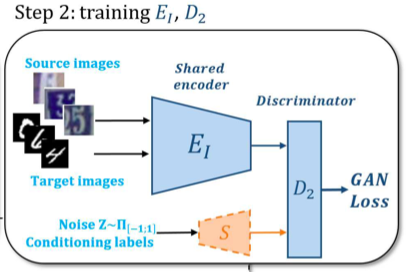

### Preliminary steps

In [ ]:
class FeatureDiscriminator2(nn.Module):
    def __init__(self, in_features):
        super(FeatureDiscriminator2, self).__init__()

        self.discriminator = nn.Sequential(
            nn.Linear(in_features=in_features, out_features=1024),
            nn.ReLU(),
            
            nn.Linear(in_features=1024, out_features=2048),
            nn.ReLU(),
            nn.Dropout(p=0.5),

            nn.Linear(in_features=2048, out_features=2048),
            nn.ReLU(),
            nn.Dropout(p=0.5),

            nn.Linear(in_features=2048, out_features=1024),
            nn.ReLU(),
            nn.Dropout(p=0.5),

            nn.Linear(in_features=1024, out_features=512),
            nn.ReLU(),
            nn.Dropout(p=0.5),

            nn.Linear(in_features=512, out_features=1),
            nn.ReLU(),
            nn.Sigmoid()
        )
    
    def forward(self, x):
        out = self.discriminator(x)
        return out

In [ ]:
def init_discriminator(feat_size):

    netD = FeatureDiscriminator2(in_features=feat_size[0])
    netD.apply(weight_init)

    return netD

In [ ]:
def load_discriminator():
    netD = torch.load(f'{MODELS_PATH}/feature_discriminator_source_target.pt')
    return netD

In [ ]:
def generate_random_labels(size):
    return torch.randint(low=0, high=20, size=(size,))

In [ ]:
def train_gan(encoder,
              source_net,
              feat_size,
              feature_generator,
              train_source_loader,
              train_target_loader,
              visualization_name,
              criterion,
              n_epochs=20, 
              noise_len=100,
              device='cuda:0', 
              learning_rate_e=0.001,
              learning_rate_d=0.001,
              n_classes=20,
              checkpoint_path='./checkpoints',
              encoder_checkpoint_path='encoder_invariant_checkpoint.pt',
              discriminator_checkpoint_path='discriminator2_checkpoint.pt',
              drive_checkpoint_path=None,
              drive_log_path=None,
              save_checkpoint_every=10):
  
    # if a log path is specified use that path for the logger otherwise use runs/ 
    if drive_log_path and os.path.exists(drive_log_path):
        print(f"[*] Drive log path found [{drive_log_path}]")
        writer = SummaryWriter(log_dir=join(drive_log_path, f"{visualization_name}"))
    else:
        print(f"[*] Drive log path not found")
        writer = SummaryWriter(log_dir=f"runs/{visualization_name}")

    #define labels
    generated_label = 0.9
    encoded_label = 0.0
    
    #generated_label = 0.0
    #encoded_label = 0.9

    # init networks
    # netD = init_discriminator(feat_size)
    netD = load_discriminator()
    
    netD.to(device)
    encoder.to(device)
    feature_generator.to(device)

    # init optimizers
    encoder_optim, netD_optim = get_feature_gan_optimizers(encoder, netD, learning_rate_e, learning_rate_d)

    checkpoint = None
    # check local checkpoint folder and create it if not present
    if not os.path.exists(checkpoint_path):
        print(f"[*] Local checkpoint folder not found [{checkpoint_path}]")
        os.mkdir(checkpoint_path)
        iters_encoder = 0
        iters_discriminator = 0
        iters = 0
        start_epoch_encoder = 0
        start_epoch_discriminator = 0
        start_epoch = 0
    else:
        print("[*] Local checkpoint folder found")
        checkpoint = checkpoint_path

    # check drive checkpoint folder and create it if not present
    if drive_checkpoint_path:
        if not os.path.exists(drive_checkpoint_path):
            print(f"[*] Drive checkpoint folder not found [{drive_checkpoint_path}]")
            os.mkdir(drive_checkpoint_path)
        else:
            print("[*] Drive checkpoint folder found")
            checkpoint = drive_checkpoint_path
    else:
        print("[*] Drive checkpoint path argument not present (drive_checkpoint_path)")

    # load checkpoints. Priority is given to drive folder
    if checkpoint:
        print("[*] Restoring checkpoints")

        try:
            encoder_checkpoint = torch.load(join(checkpoint, encoder_checkpoint_path))
            encoder.load_state_dict(encoder_checkpoint['model_state_dict'])
            encoder_optim.load_state_dict(encoder_checkpoint['optimizer_state_dict'])
            lossE = encoder_checkpoint['loss']

            iters_encoder = encoder_checkpoint['iters']
            start_epoch_encoder = encoder_checkpoint['epoch'] + 1

            encoder_checkpoint = None
            
            print("[*] Encoder checkpoint file loaded successfully")
        except FileNotFoundError:
            print("[*] Encoder checkpoint file not found. Starting from zero")
            iters_encoder = 0
            start_epoch_encoder = 0

        try:
            discriminator_checkpoint = torch.load(join(checkpoint, discriminator_checkpoint_path))
            netD.load_state_dict(discriminator_checkpoint['model_state_dict'])
            netD_optim.load_state_dict(discriminator_checkpoint['optimizer_state_dict'])
            lossD = discriminator_checkpoint['loss']
            
            iters_discriminator = discriminator_checkpoint['iters']
            start_epoch_discriminator = discriminator_checkpoint['epoch'] + 1

            discriminator_checkpoint = None
            print("[*] Discriminator checkpoint file loaded successfully")
        except FileNotFoundError:
            print("[*] Discriminator checkpoint file not found. Starting from zero")
            iters_discriminator = 0
            start_epoch_discriminator = 0
        
        start_iters = min(iters_encoder, iters_discriminator)
        iters = start_iters
        start_epoch = min(start_epoch_encoder, start_epoch_discriminator)

    def train_step(data, epoch, iters, use_labels=True):
        netD.train()
        netD.zero_grad()

        bs = data[0].shape[0]
        # noise
        z = generate_noise((bs, noise_len))
        # one hot label
        if use_labels:
            oh_labels = one_hot(data[1], n_classes)
        else:
            # oh_labels = one_hot(generate_random_labels(bs), n_classes)
            pseudo_labels = source_net(next(iter(train_source_loader))[0].to(device))
            pseudo_labels = torch.argmax(pseudo_labels,dim=1)
            oh_labels = one_hot(pseudo_labels, n_classes)

        # concat
        noise_labels = torch.cat((z, oh_labels), dim=1).to(device)

        # get real features from backbone encoder
        generated_feats_raw = feature_generator(noise_labels)
        # predict real or fake
        labels = torch.full((bs, ), generated_label).to(device)
        outputs = netD(generated_feats_raw.view(bs, -1)).view(-1)

        # loss on real features
        lossD_generated = criterion(outputs.clone(), labels.clone())

        # generate fake labels
        encoded_feats_raw = encoder(data[0].to(device))
                    
        # predict real or fake
        labels.fill_(encoded_label)
        outputs = netD(encoded_feats_raw.view(bs, -1).detach()).view(-1)

        # loss on fake features
        lossD_encoded = criterion(outputs.clone(), labels.clone())
        # discriminator loss
        lossD = lossD_generated + lossD_encoded + torch.abs((lossD_encoded - lossD_generated))
        lossD.backward(retain_graph=True)

        netD_optim.step()

        # generator
        encoder.train()
        encoder.zero_grad()

        # feature matching
        generated_feats_raw = generated_feats_raw.view(bs, -1)
        encoded_feats_raw = norm_scale(encoded_feats_raw.view(bs, -1), generated_feats_raw.view(bs, -1))
        
        if use_labels:
            lossFeature = criterion(generated_feats_raw.clone(), encoded_feats_raw.view(bs, -1))
        else:
            lossFeature = 0

        # predict real or fake and compute generator gradients
        labels.fill_(generated_label)
        outputs = netD(encoded_feats_raw.view(bs, -1)).view(-1)
        lossE = criterion(outputs, labels) #+ lossFeature


        lossE.backward()
        encoder_optim.step()
        
        writer.add_scalar('Domain_Invariant_Loss/D_loss_generated', lossD_generated, iters)
        writer.add_scalar('Domain_Invariant_Loss/D_loss_encoded', lossD_encoded, iters)
        writer.add_scalar('Domain_Invariant_Loss/D_loss', lossD, iters)
        writer.add_scalar('Domain_Invariant_Loss/E_loss', lossE, iters)

        iters += 1

        return iters, lossD, lossD_encoded, lossD_generated, lossE, lossFeature
    
    for epoch in range(start_epoch, n_epochs):

        for data in train_source_loader:
            iters, lossD, lossD_encoded, lossD_generated, lossE, lossFeature = train_step(data, epoch, iters, use_labels=True)
        
        print(f"[{epoch + 1}/{n_epochs}] [{iters} iters] [Source] D_loss (encoded + generated): {lossD}  ({lossD_encoded} + {lossD_generated}) E_loss (encoder + feature_matching): {lossE} ({lossE - lossFeature} + {lossFeature})")

        for data in train_target_loader:
            iters, lossD, lossD_encoded, lossD_generated, lossE, lossFeature = train_step(data, epoch, iters, use_labels=True)

        print(f"[{epoch + 1}/{n_epochs}] [{iters} iters] [Target] D_loss (encoded + generated): {lossD}  ({lossD_encoded} + {lossD_generated}) E_loss (encoder + feature_matching): {lossE} ({lossE - lossFeature} + {lossFeature})")

        # save checkpoints
        if (epoch + 1) % save_checkpoint_every == 0:
            print("[*] Saving checkpoints")
            
            torch.save({
                'epoch': start_epoch_encoder + epoch - start_epoch,
                'model_state_dict': encoder.state_dict(),
                'optimizer_state_dict': encoder_optim.state_dict(),
                'loss': lossE,
                'iters': iters_encoder + iters - start_iters,
                }, join(checkpoint_path, encoder_checkpoint_path))
            
            torch.save({
                'epoch': start_epoch_discriminator + epoch - start_epoch,
                'model_state_dict': netD.state_dict(),
                'optimizer_state_dict': netD_optim.state_dict(),
                'loss': lossD,
                'iters': iters_discriminator + iters - start_iters,
                }, join(checkpoint_path, discriminator_checkpoint_path))
                        
            if drive_checkpoint_path:
                copyfile(join(checkpoint_path, encoder_checkpoint_path), join(drive_checkpoint_path, encoder_checkpoint_path))
                copyfile(join(checkpoint_path, discriminator_checkpoint_path), join(drive_checkpoint_path, discriminator_checkpoint_path))
    
    return encoder, netD

### **Source → Target** training

In [ ]:
%%capture

# load trained network
source_net = torch.load(f'{MODELS_PATH}/baseline_source.pt')
source_net.to('cuda:0')

es_source_target, c_source_target = split_encoder_classifier(source_net)

feat_size = 0

for im, label in train_source_loader:
    feats = es_source_target(im[0].unsqueeze(0).cuda())
    feat_size = feats.view(-1).shape
    print(feat_size)
    break

ei_source_target = es_source_target
netG = torch.load(f'{MODELS_PATH}/feature_generator_source_target.pt')

In [ ]:
encoder_source_target, netD = train_gan(ei_source_target,
                                        source_net,
                                        feat_size,
                                        netG,
                                        train_source_loader_notAug,
                                        train_target_loader_notAug, 
                                        'domain_invariant_gan_source_target_old_disc_pseudo_labels',
                                        criterion=get_loss(),
                                        n_epochs=20, 
                                        noise_len=feat_size.numel(),
                                        device='cuda:0',
                                        learning_rate_e=0.0003,
                                        learning_rate_d=0.00003,
                                        n_classes=20,
                                        checkpoint_path='./checkpoints',
                                        encoder_checkpoint_path='encoder_invariant_checkpoint_old_disc_pseudo_labels.pt',
                                        discriminator_checkpoint_path='discriminator_checkpoint.pt',
                                        drive_checkpoint_path=MODELS_PATH,
                                        drive_log_path=LOGS_PATH)
encoder_source_target.to('cpu')
netD.to('cpu')

torch.save(encoder_source_target, f"{MODELS_PATH}/encoder_invariant_source_target_pseudo_labels.pt")

torch.cuda.empty_cache()

### **Target → Source** training

In [ ]:
%%capture

target_net = torch.load(f'{MODELS_PATH}/baseline_target.pt')
target_net.to('cuda:0')

es_target_source, c_target_source = split_encoder_classifier(target_net)

feat_size = 0

for im, label in train_target_loader:
    feats = es_target_source(im[0].unsqueeze(0).cuda())
    feat_size = feats.view(-1).shape
    print(feat_size)
    break

ei_target_source = es_target_source
netG = torch.load(f'{MODELS_PATH}/feature_generator_target_source.pt')

In [ ]:
encoder_target_source, netD = train_gan(ei_target_source,
                                        feat_size,
                                        netG,
                                        train_mixed_loader, 
                                        'domain_invariant_gan_target_source',
                                        criterion=get_loss(),
                                        n_epochs=20, 
                                        noise_len=feat_size.numel(),
                                        device='cuda:0',
                                        learning_rate_e=0.0003,
                                        learning_rate_d=0.0003,
                                        n_classes=20,
                                        checkpoint_path='./checkpoints',
                                        encoder_checkpoint_path='encoder_invariant_checkpoint_target_source.pt',
                                        discriminator_checkpoint_path='discriminator2_checkpoint_target_source.pt',
                                        drive_checkpoint_path=MODELS_PATH,
                                        drive_log_path='/content/gdrive/MyDrive/Logs/runs')
encoder_target_source.to('cpu')
netD.to('cpu')

torch.save(encoder_target_source, f"{MODELS_PATH}/encoder_invariant_target_source.pt")

torch.cuda.empty_cache()

### Final tests

In [ ]:
def final_test_step(encoder, classifier, data_loader, cost_function, device='cuda'):

    samples = 0.
    cumulative_loss = 0.
    cumulative_accuracy = 0.

    outputs_all = []
    targets_all = []

    encoder.to(device)
    classifier.to(device)

    # set the network to evaluation mode
    encoder.eval() 
    classifier.eval()

    # disable gradient computation
    with torch.no_grad():

        # iterate over the test set
        for i, data in enumerate(data_loader):

            bs = data[0].shape[0]

            inputs = data[0]
            targets = data[1]

            # load data into GPU
            inputs = inputs.to(device)
            targets = targets.to(device)
                
            # forward pass
            e_outputs = encoder(inputs).view(bs, -1)
            outputs = classifier(e_outputs)

            # loss computation
            loss = cost_function(outputs, targets)

            # fetch prediction and loss value
            samples += inputs.shape[0]
            cumulative_loss += loss.item()
            _, predicted = outputs.max(dim=1)

            # compute accuracy
            cumulative_accuracy += predicted.eq(targets).sum().item()

            outputs_all.extend(predicted.cpu().tolist())
            targets_all.extend(targets.cpu().tolist())

    return cumulative_loss/samples, cumulative_accuracy/samples*100, outputs_all, targets_all

**Source → Target** test:

Domain invariant encoder trained supervisedly on the source domain and unsupervisedly on the target domain tested on target domain

In [ ]:
source_net = torch.load(f'{MODELS_PATH}/baseline_source.pt')
source_net.to('cuda:0')

es_source_target, c_source_target = split_encoder_classifier(source_net)

encoder_source_target = torch.load(f"{MODELS_PATH}/encoder_invariant_source_target_pseudo_labels.pt")

cost = torch.nn.CrossEntropyLoss()
test_loss, test_accuracy, outputs, targets = final_test_step(encoder_source_target, c_source_target, test_target_loader, cost)
print("Target test using source network: ", test_loss, test_accuracy)

ConfusionMatrixDisplay.from_predictions(targets, outputs)
plt.show()

**Target → Source** test:

Domain invariant encoder trained supervisedly on the target domain and unsupervisedly on the source domain tested on source domain

In [ ]:
target_net = torch.load(f'{MODELS_PATH}/baseline_target.pt')
target_net.to('cuda:0')

es_target_source, c_target_source = split_encoder_classifier(target_net)

encoder_target_source = torch.load(f"{MODELS_PATH}/encoder_invariant_target_source.pt")

cost = torch.nn.CrossEntropyLoss()
test_loss, test_accuracy, outputs, targets = final_test_step(encoder_target_source, c_target_source, test_source_loader, cost)
print("Source test using target network: ", test_loss, test_accuracy)

ConfusionMatrixDisplay.from_predictions(targets, outputs)
plt.show()

###**Step 1**
Thanks to the adversarial setup we ensure the generator is able to produce features that are as similar as possible to the ones of the encoder.
In this way we ensure that our generator will be able to produce an infinite number of synthetic features relative to the source domain.

Unforunately this step requires a lot of iteration to give satisfying results, through the mean squared distance between generated and encoded features we are able to understand if the training is doing well.

After the training the discriminator is dropped and only the generator is saved for the successive step.

---

###**Step 2**
Here comes the true *Domain Adaptation* part.
We setup another GAN, but its roles will be swapped: the generator trained in the previous step is now used to produce features that we will consider as *real features*, while the encoder will produce the *fake features*.
We use a new encoder initialized with the weights of the one trained in step 0, it will learn to produce domain agnostic features.

**Key point:** the encoder at first is able only to produce features that belong to the source domain, but now it will be fed with both source domain and target domain images.

Thanks to the adversarial setup the discriminator will try to distinguish features coming from the generator or the encoder, so the only way the encoder has to fool the generator is to be sure it produces features that, no matter what domain the images come from, must be as similar as possible to the ones of the generator, which, remember, outputs source domain features.

---

###**Test step**
At this point the encoder is able to take target domain images and encode them with features that are similar to the source domain features.
Thanks to this we can use the classificator used at step 0 to train the first encoder to test the new domain invariant encoder.

---



## Conclusions

We did not achieve significant results, the performance of our model were even worst than the baseline.

We tried many configurations to better understand the issues of our solution, here are some ipothesis:

- The dataset is too small to train a GAN, it would have been better to train it on the whole dataset, but this would have taken too long to complete. Our model already took almost an entire week to train
- The author of the paper tested their solution on digit classification, a mush simpler task than ours.
- They used an ad-hoc encoder for the task, which complexity was similar to the ones of the discriminator and the generator, while we used a ResNet50, much more complex than theirs, and instead kept the same discriminator and generator. We think that the GAN structure was not complex (deep) enough to imitate the features encoded by the resnet (among other things, lack of convolutional layers). But to get deeper was out of question since the already long training time.
- We discovered that in step 2 the encoder and the generator already produced too good features for the discriminator to identify them correctly.
Basically the discriminator start its training from 0 whereas the encoder is already able to fool it every time.


###**Possible solutions**

For this assignment it has been used a resnet50 as encoder, we strongly believe that in order to see the full power of this idea, together with the encoder also the generator and discriminators should be improved, moreover a bigger dataset could be used.


We think that the generator could be modified to better resemble the feature encoder, as it wat thought in the original paper. For this purpose it could be deeper, convolutional layers could be added or substituted to some of the linear layer in order to diminish the number of weights.

Another possibility is to add an extra step at the very end of the training to fine-tune the encoder with self-supervised learning.

Hyper-parameters can be fine-tuned to achieve better results.

Our biggest obstacle to the implementations of this improvements was the training time: everything has been trained on colab, but every run took days to finish so we didn't have the time to try everything we had in mind.
Also we are aware that the decision to use GANs was bold since it provides very few indications about the training situations, and therefore it is challenging to carry an error analysis.
We tried printing learning curves but they don't represent anything significant, the only useful information is the feature distance and the final classification scores like the accuracy or more in general the confusion matrix.

It has already been said that the discriminator used in step 2 (domain invariant encoder training) was not good enough to match the encoder and thus we had to use the features distance to guide the training. 
A possible solution could be to initialize the discriminator with an intermediate state of the discriminator used in step 1, we did not do it at last because our discriminators had different structures.